# Serialization Walkthrough

In [ ]:
from datetime import datetime
from pydantic import BaseModel, Json
from typing import Any, List

Now lets define a class that inherits from the BaseModel

In [ ]:
class Location(BaseModel):
    lat: float
    lon: float

class Meeting(BaseModel):
    when: datetime
    where: str = 'Satori Athens Offices'
    why: str = 'Party'
    location: Location

In [ ]:
location = Location(lat=37.9838, lon=23.7275)
meet = Meeting(when='2020-01-01T12:00', where='Satori Offices', location=location)

## To dict

In [ ]:
# Simple as that to convert it to a python dict
value = dict(location)
value

## model_dump & model_dump_....

In [ ]:
meet.model_dump(exclude_unset=True)

In [ ]:
# Here we get the why field as well but it was not set
meet.model_dump()

In [ ]:
# If you want to present the data directly into the app
meet.model_dump_json()

In [ ]:
meet.model_dump_json(indent=1)

In [ ]:
print(meet.model_dump_json(indent=2))

In [ ]:
# for field_name, field_value in model also works in pydantic but sub-models will not be converted to dictionaries
for field_name, field_value in meet:
    print(field_name, "-->", field_value)

In [ ]:
# Make the call appropriate for JSON serialization to be sent in the database
# mode: Literal["json", "python"] | str = "python"

meet.model_dump(exclude={'where'}, mode='json')

In [ ]:
meet.model_dump(exclude={'where'}, mode='json')

In [ ]:
# Or directly select what will be sent with include
print(meet.model_dump_json(include={'when', 'where'}))

#### Round trip explanation

In [ ]:
class ListJson(BaseModel):
    jsn_list: List[Json[Any]]

json_list = ListJson(jsn_list=['{"a": 1}', '{"b": 2}'])

In [ ]:
# Serialize the json list
json_list.model_dump()

In [ ]:
# Indicates that the serialization process should preserve the format of the original input data as closely as possible.
json_list.model_dump(round_trip=True)

## Custom Serializers

In [ ]:
# All the available custom serializers in pydantic
from pydantic import BaseModel, field_serializer, model_serializer, PlainSerializer, WrapSerializer

from typing import Set, Literal, List, Any, Dict
from typing_extensions import Annotated
import numpy as np
from datetime import datetime, timezone

### field_serializer

Decorator that enables **custom field serialization**.

In [ ]:
class Satorian(BaseModel):
    name: str
    favouite_drinks: Set[str]

    @field_serializer('favouite_drinks')
    def serialize_favourite_drinks_with_alphabetical_order(favouite_drinks: Set[str]):
        return sorted(favouite_drinks)

employee = Satorian(name = "John Wick", favouite_drinks={'Old Fashioned', 'Aperol Spritz', 'Negroni', 'Tom Collins', 'Martini','Margarita'})
print(employee.model_dump_json(indent=4))

### model_serializer

Decorator that enables **custom model serialization**. 
This is useful when a model need to be serialized in a customized manner, allowing for flexibility beyond just specific fields.

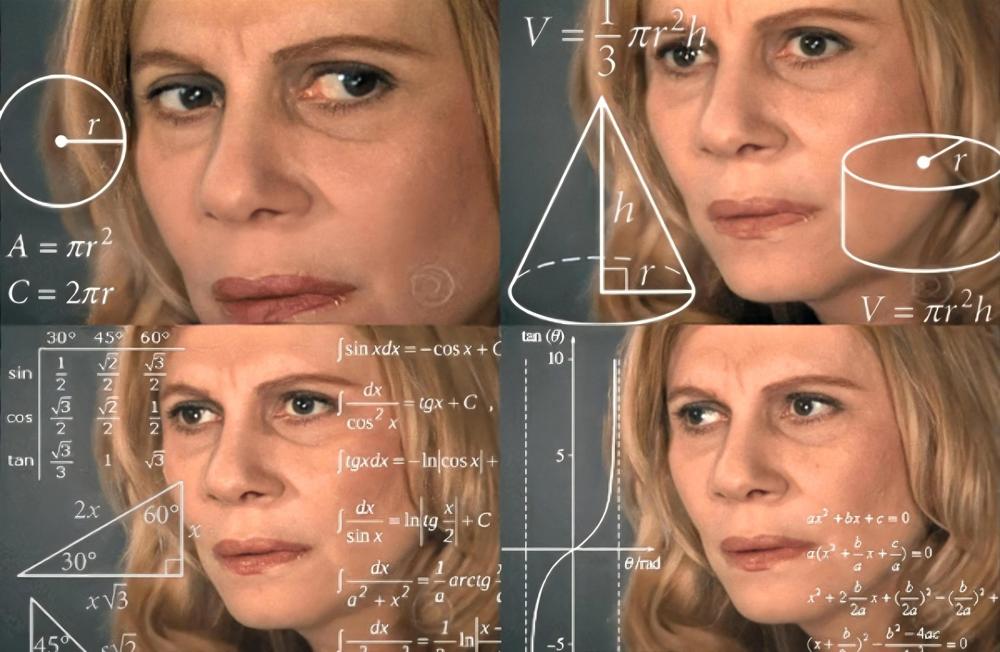

In [ ]:
class PizzaModel(BaseModel):
    unit: Literal['diameter', 'circumference', 'radius', 'area']
    value: float

    @model_serializer()
    def serialize_pizza_model(self):
        if self.unit == 'circumference':
            return {'unit': '', 'value': self.value / np.pi}
        if self.unit == 'radius':
            return {'unit': 'diameter', 'value': self.value * 2}
        if self.unit == 'area':
            return {'unit': 'diameter', 'value': 2 * np.sqrt(self.value / np.pi)}
        return {'unit': self.unit, 'value': self.value}

In [ ]:
pizza = PizzaModel(unit='area', value=32)
print(pizza.model_dump_json(indent=2))

### PlainSerializer 

Plain serializers is a wrapper that **use a function to modify the output** of serialization.

In [ ]:
CustomString = Annotated[List, PlainSerializer(lambda x: ', '.join(x), return_type=str)]

class SatoriansOrder(BaseModel):
    order_list: CustomString
    # order_list: List[str]

order = SatoriansOrder(order_list=['Old Fashioned', 'Aperol Spritz', 'Negroni', 'Tom Collins', 'Pizza for newcomers', 'Feyrouz'])
print(order.model_dump_json(indent=2))

### WrapSerializer 

Wrap serializer **receive the raw input along with a handler function that applies the standard serialization logic**, and can modify the resulting value before returning it as the final output of serialization.

In [ ]:
class SatoriEventDatetime(BaseModel):
    start: datetime
    end: datetime

def convert_to_utc(value: Any, handler, info) -> Dict[str, datetime]:
    partial_result = handler(value, info)
    if info.mode == 'json':
        return {
            k: datetime.fromisoformat(v).astimezone(timezone.utc) for k, v in partial_result.items()
        }
    return {k: v.astimezone(timezone.utc) for k, v in partial_result.items()}

In [ ]:
UTCEventDatetime = Annotated[SatoriEventDatetime, WrapSerializer(convert_to_utc)]

class EventModel(BaseModel):
    event_datetime: UTCEventDatetime

satori_event_time = SatoriEventDatetime(
    start='2024-04-04T15:00:00+02:00', end='2024-04-03T17:00:00+02:00'
)
event = EventModel(event_datetime=satori_event_time)
print(event.model_dump())

In [ ]:
print("Event time in UTC so Mark in UK will don't perform calculations each time:")
print(event.model_dump_json(indent=2))

## Pickle works!

In [ ]:
import pickle

In [ ]:
databytes = pickle.dumps(satori_event_time)
databytes

In [ ]:
retreived_event_data = pickle.loads(databytes)
print(retreived_event_data.model_dump_json(indent=2))

## Speak with Meltemi

In [ ]:
import requests

In [ ]:
class MeltemiInferenceInput(BaseModel):
    system_propmt: str
    user_propmt: str
    generation_conf: Dict[str, Any] = {
        'max_new_tokens': 300,
        'temperature': 0.4,
    }

In [ ]:
sent_data = MeltemiInferenceInput(
    system_propmt='Είσαι ενας ειδικός ξεναγός και απαντάς επιστημονικά με ιστορικά γεγονότα στις ερωτήσεις των τουριστών', 
    user_propmt='Πότε φτιάχτηκε ο Παρθενώνας;'
    )

sent_data.model_dump()

In [ ]:
response = requests.post('http://43.230.163.163:23118/ask_meltemi', json=sent_data.model_dump())
print(f'The response returned with status code {response.status_code}!')
if response.status_code == 200:
    answer = response.json()['answer']
    print(f'{answer}')